In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import pandas as pd
import funs
import seaborn as sns
import plotly.plotly as py
from plotly.graph_objs import *
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot
init_notebook_mode(connected=True)

In [ ]:
tablas={}
for nodo in [2,3,5]:
    tablas[nodo] = pd.read_csv('Periodos_nodo%s'%nodo,parse_dates=True,index_col=0)
df = pd.read_csv('nodos235')

## Mormaliza las variables

In [13]:
DF = df.copy()
df.iloc[:,1:6] = StandardScaler().fit_transform(df.iloc[:,1:6])
#df2 = pd.DataFrame(df2)
#df2.columns = df.iloc[:,1:6].columns
#df2.index = df.index
#df.iloc[:,1:6] = df2
df

,NODO,TEMPERATURA,HUMEDAD RELATIVA,HUMEDAD DE LA TIERRA,NIVEL UV,INTENSIDAD LUMÍNICA,HORA
TIME,,,,,,,
2018-05-09 09:38:00,2,-0.365476,-1.303878,1.168079,-0.193985,0.027809,9
2018-05-09 09:38:00,6,-2.463644,-2.102990,-1.112554,-0.193985,-0.043789,9
2018-05-09 09:49:00,3,-0.365476,0.630816,1.749112,-0.193985,0.027454,9
2018-05-09 09:49:00,6,-2.463644,-2.102990,-1.112554,-0.193985,-0.043789,9
2018-05-09 09:49:00,2,-0.287766,-1.303878,1.099633,-0.193985,0.027956,9
...,...,...,...,...,...,...,...
2018-06-11 09:17:00,8,2.198952,1.177577,-1.082741,-0.193985,0.027809,9
2018-06-11 09:17:00,3,0.023074,-0.883292,-1.077874,-0.193985,0.027589,9
2018-06-11 09:17:00,2,0.023074,-1.387995,-1.087609,-0.193985,0.027809,9


In [14]:
n = df.NODO.value_counts()
# imprime los nodos contenidos en df y la cantidad de registros que posee
print(n)
nodos  = n.index.tolist()

3    14363
5    11771
2    11042
8     8440
6     1669
4      394
Name: NODO, dtype: int64


## Separa los nodos

In [15]:
tabla = []
for i in nodos:
    tabla_nodo = df.query('NODO == %s' %i).copy()#.reset_index(drop=False)
    tabla_nodo.columns = [j+str(tabla_nodo.NODO[0]) for j in tabla_nodo.columns]
    tabla_nodo.drop(columns = ['NODO%s'%i],inplace=True)
    tabla.append(tabla_nodo)

## Realiza una gráfica interactiva de valores medidos por un nodo

### "tablas" es un diccionario de DFs. Para acceder al DF correspondiente a cada nodo se hace tabla[nodo], tabla[2] (nodo 2).
#### Cada DF tiene 7 columnas:
0 - TEMPERATURA  
1 - HUMEDAD RELATIVA  
2 - HUMEDAD DE LA TIERRA  
3 - HUMEDAD DE LA TIERRA  
4 - NIVEL UV  
5 - INTENSIDAD LUMÍNICA  
6 - HORA  
7 - TIME  

In [16]:
for nodo in nodos:
    data = ([{'x': tablas[nodo].index,'y': tablas[nodo][col],'name': col}
             for col in tablas[nodo].columns[0:5]])
    layout = dict(title = 'NODO %s' %nodo,
                  yaxis = dict(title = 'MAGNITUD'),
                  xaxis = dict(title = 'FECHA')
                 )
    fig = dict(data=data, layout=layout)
    iplot(fig,layout)

## Se presentan los periodos de medición observados para cada nodo, calculados para separaciones de más de 60 minutos entre los registros


In [17]:
# Aplica la función separa_nodos, que calcula el tamaño de los dataframes entre periodos de medición con separación #edge"
data, info = {}, {}
for i in nodos:
    data[i], info[i] = funs.separa_datos(tablas[i],60)
info

NODO 3
NODO 5
NODO 2
NODO 8
NODO 6
NODO 4


## Apartir de la información anterior se tiene que:  
- ### los nodos 2, 3, 5 estuvieron funcionando en tres periodos de tiempo consecutivos.
### Dicha simultaneidad se presenta mayormente entre las fechas:  
- 2018-05-09 10:26:00 2018-05-10 14:37:00  
- 2018-05-23 10:09:00 2018-05-26 07:01:00  
- 2018-06-05 10:22:00 2018-06-08 18:40:00
- ### El nodo 8 comenzó a funcionar desde el 24 de mayo y apartir de ese peridodo sus mediciones concuerdan con algunos periodos de medición de los nodos 2, 3 y 5.  
  
### la simultaneidad  de mayor rango se presenta entre las fechas:
- 2018-05-24 09:42:00 2018-05-26 07:01:00  
- ### Los nodos 6 y 8 presentan la menor cantidad de registros y se encuentran en fechas dispares a las de los demás nodos.

## Concatena los DFs contenidos en tabla

In [18]:
tabla = pd.concat(tabla).sort_index()
tabla

C:\Users\Jergb\Anaconda3\lib\site-packages\ipykernel_launcher.py:1: FutureWarning:

Sorting because non-concatenation axis is not aligned. A future version
of pandas will change to not sort by default.

To accept the future behavior, pass 'sort=True'.

To retain the current behavior and silence the warning, pass sort=False




,HORA2,HORA3,HORA4,HORA5,HORA6,HORA8,HUMEDAD DE LA TIERRA2,HUMEDAD DE LA TIERRA3,HUMEDAD DE LA TIERRA4,HUMEDAD DE LA TIERRA5,...,NIVEL UV4,NIVEL UV5,NIVEL UV6,NIVEL UV8,TEMPERATURA2,TEMPERATURA3,TEMPERATURA4,TEMPERATURA5,TEMPERATURA6,TEMPERATURA8
TIME,,,,,,,,,,,,,,,,,,,,,
2018-05-09 09:38:00,9.0,NaN,NaN,NaN,NaN,NaN,1.168079,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,-0.365476,NaN,NaN,NaN,NaN,NaN
2018-05-09 09:38:00,NaN,NaN,NaN,NaN,9.0,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,-0.193985,NaN,NaN,NaN,NaN,NaN,-2.463644,NaN
2018-05-09 09:49:00,NaN,9.0,NaN,NaN,NaN,NaN,NaN,1.749112,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,-0.365476,NaN,NaN,NaN,NaN
2018-05-09 09:49:00,NaN,NaN,NaN,NaN,9.0,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,-0.193985,NaN,NaN,NaN,NaN,NaN,-2.463644,NaN
2018-05-09 09:49:00,9.0,NaN,NaN,NaN,NaN,NaN,1.099633,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,-0.287766,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2018-06-11 09:17:00,NaN,NaN,NaN,NaN,NaN,9.0,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,-0.193985,NaN,NaN,NaN,NaN,NaN,2.198952
2018-06-11 09:17:00,9.0,NaN,NaN,NaN,NaN,NaN,-1.087609,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,0.023074,NaN,NaN,NaN,NaN,NaN
2018-06-11 09:17:00,NaN,9.0,NaN,NaN,NaN,NaN,NaN,-1.077874,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,0.023074,NaN,NaN,NaN,NaN


## Ordena las columnas por orden alfabético

In [19]:
tabla = tabla.reindex(columns = sorted(tabla.columns))

## Matrices de correlación entre variables de diferentes nodos

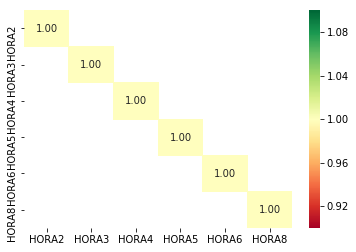

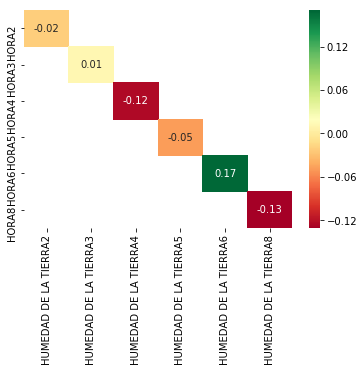

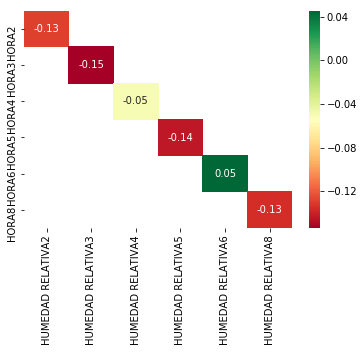

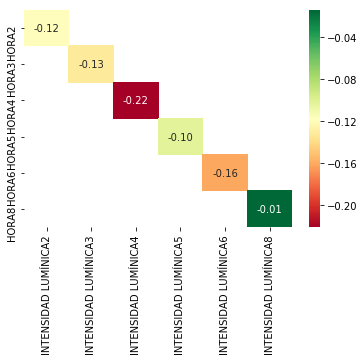

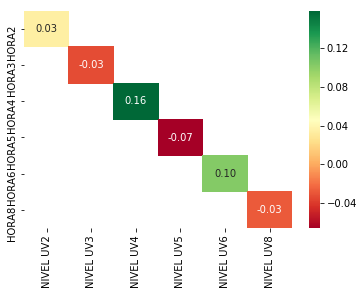

...

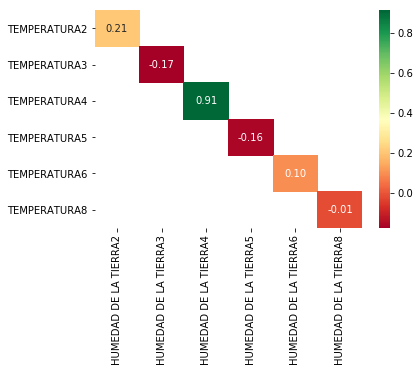

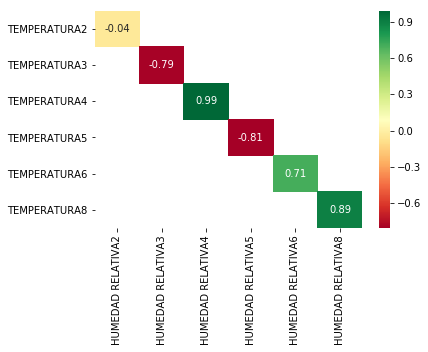

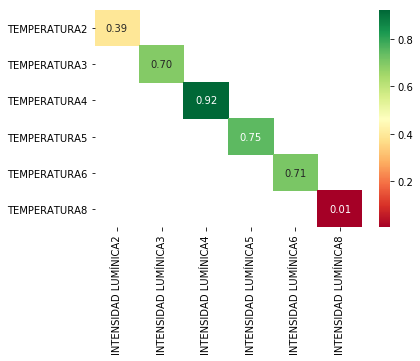

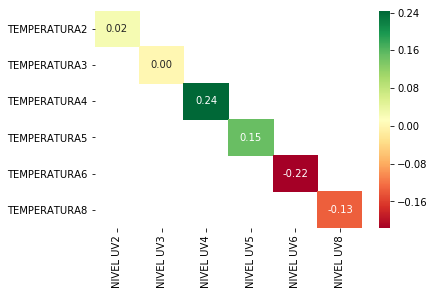

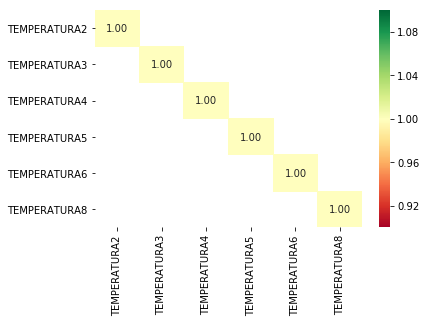

In [20]:
tcorr = tabla.corr()
for i in range(0,len(tcorr),6):
    for j in range(0,len(tcorr),6):
        sns.heatmap(tcorr[i:i+6].iloc[:,j:j+6], annot=True, cmap='RdYlGn',fmt=".2f")
        plt.show()

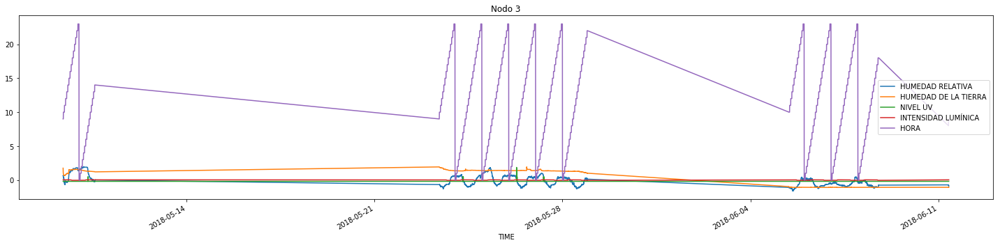

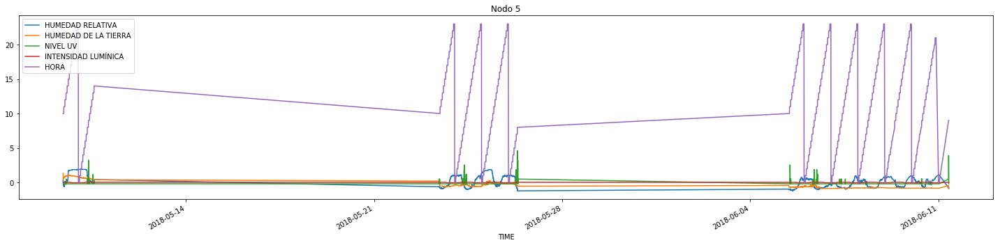

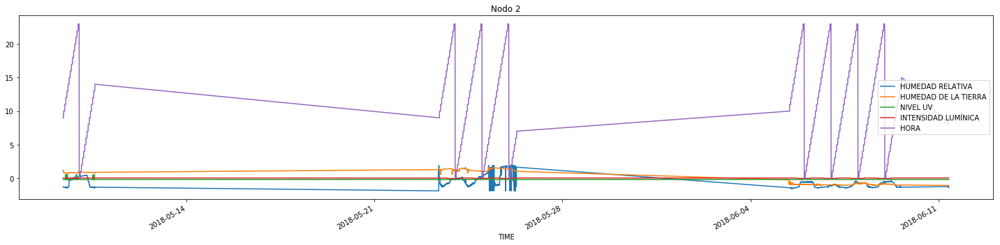

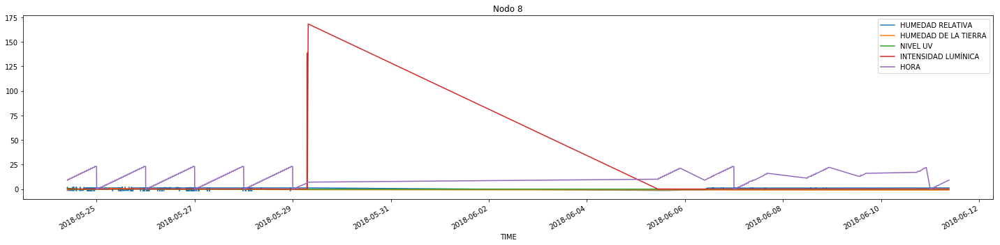

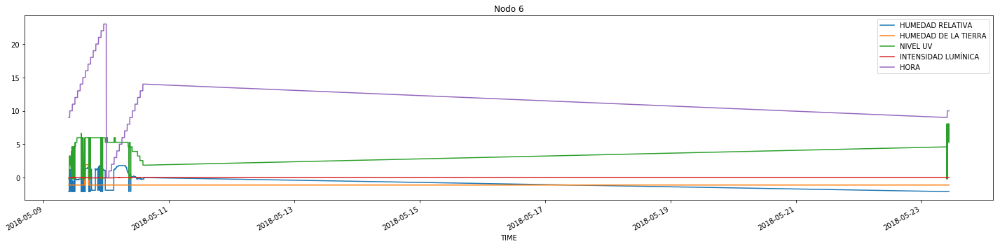

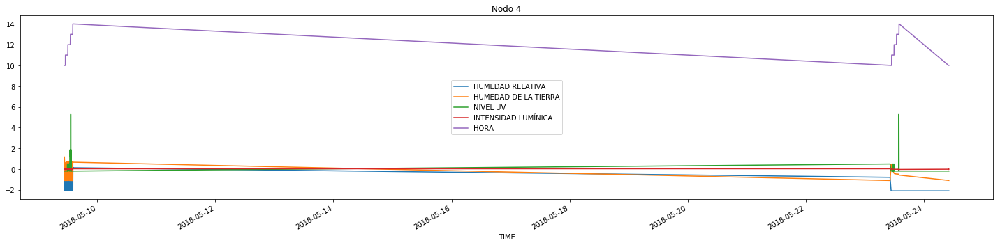

In [21]:
# presentación gráfica de las variables entre los nodos, pero con matplotlib :v
# nodos = 2;3;4;5;6;8
for nodo in nodos:
    ejey = tablas[nodo].columns[1:6]
    tablas[nodo].plot(y = ejey, figsize=[20,5],title='Nodo %d'%nodo)
    plt.tight_layout()

ValueError: cannot reindex from a duplicate axis

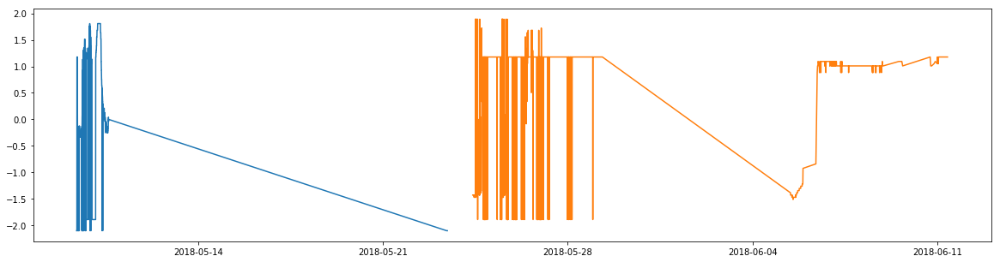

In [22]:
# grafica una variable para dos nodos y calcula la correlación de los dos nodos respecto a esa variable.
variable = tablas[2].columns[1]
plt.figure(figsize = [20,5])
nodo1 = 6
nodo2 = 8
for nodo in [nodo1, nodo2]:
    plt.plot(tablas[nodo].index,tablas[nodo][variable])
ncorr = pd.concat([tablas[nodo1].TEMPERATURA,tablas[nodo2].TEMPERATURA],axis=1).corr()
corr = ncorr.values[1][0]
plt.title('%s DE LOS NODOS %d Y %d'%(variable, nodo1, nodo2))
print('CORRELACIÓN DE %s EN LOS NODOS %d Y %d: %s'%(variable, nodo1,nodo2,corr))

In [ ]:
for i in nodos:
    (tablaso[i]).to_csv('medidas_nodo%d'%i)

In [ ]:
n2 = pd.read_csv('medidas_nodo2',parse_dates=True,index_col=0)
n2.index

In [ ]:
n2.TEMPERATURA.loc['20180611-09'].plot()